In [1]:
import scanpy as sc
import pandas as pd
from matplotlib import pylab
import random
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px
import os
import itertools
import plotly.express as px

import numpy as np
import random
import anndata as ad
from scipy.sparse import  csr_matrix, issparse
from scipy import sparse

from matplotlib.colors import TwoSlopeNorm

import scanpy.external as sce
import sys

import scvelo as scv

In [2]:
import anndata

In [3]:
anndata.__version__

'0.10.8'

In [8]:
sc.settings.set_figure_params(dpi=80, facecolor='white', dpi_save=500)
pylab.rcParams['figure.figsize'] = (6, 6)
homeDir = os.getenv("HOME")
sys.path.insert(1, homeDir+"/utils/")
from PlotPCA_components import *
from PurgeAdata import *


DS="controls_substudy"

In [9]:
import anndata2ri
import rpy2.rinterface_lib.callbacks
import logging
anndata2ri.activate()
%load_ext rpy2.ipython
rpy2.rinterface_lib.callbacks.logger.setLevel(logging.ERROR)

The rpy2.ipython extension is already loaded. To reload it, use:
  %reload_ext rpy2.ipython


# Import

In [12]:
adata = sc.read_h5ad("./adatas/3.Endpoints.{}.h5ad".format(DS))
adata.layers["counts"] = adata.X.copy()
sc.pp.normalize_total(adata, 20000)
sc.pp.log1p(adata)

In [13]:
HVGSlist = []
for line in adata.obs["line"].unique():
    adataLine = adata[adata.obs["line"] == line].copy()
    sc.pp.highly_variable_genes(adataLine, flavor="seurat", n_top_genes=3000, batch_key="replicate")
    adataLine.var.highly_variable
    HVGS = set(adataLine.var_names[adataLine.var.highly_variable_nbatches == len(adataLine.obs.replicate.unique().tolist())].tolist())
    HVGSlist.append(HVGS)

HVGSlist = list(set.intersection(*HVGSlist))

In [14]:
adata.var["highly_variable"] = adata.var_names.isin(HVGSlist)

each run contains 1 condition as expected

In [15]:
sc.tl.pca(adata)

PlottingParams: figsize:(10, 10) dpi:100 dotsize:10 legend_loc:on data fontsize:8


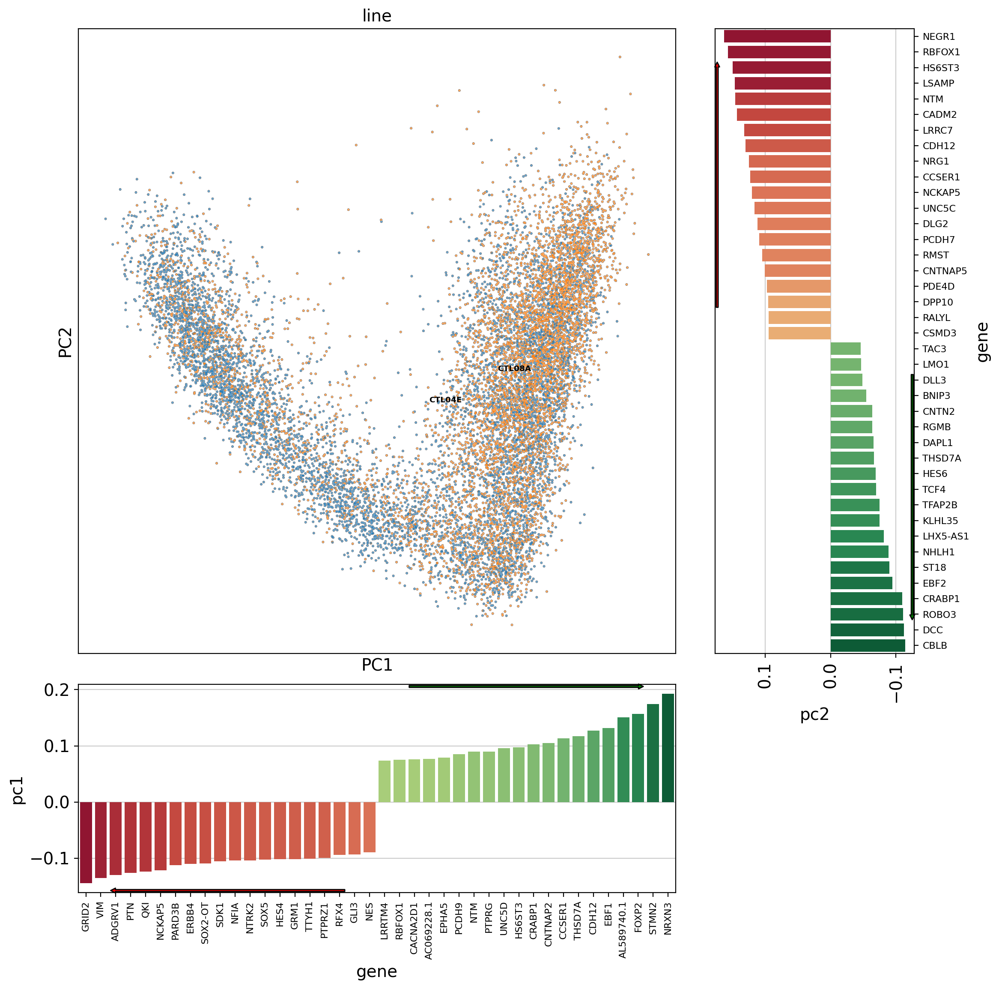

In [16]:
plotPCA_components(adata, color="line")

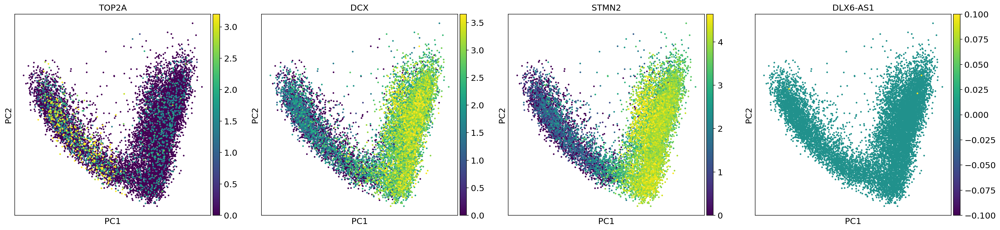

In [17]:
sc.pl.pca(adata, color=["TOP2A","DCX","STMN2", "DLX6-AS1"], ncols=4, size=30, vmin="p1", vmax="p99")

In [18]:
scv.tl.score_genes_cell_cycle(adata)

calculating cell cycle phase
-->     'S_score' and 'G2M_score', scores of cell cycle phases (adata.obs)


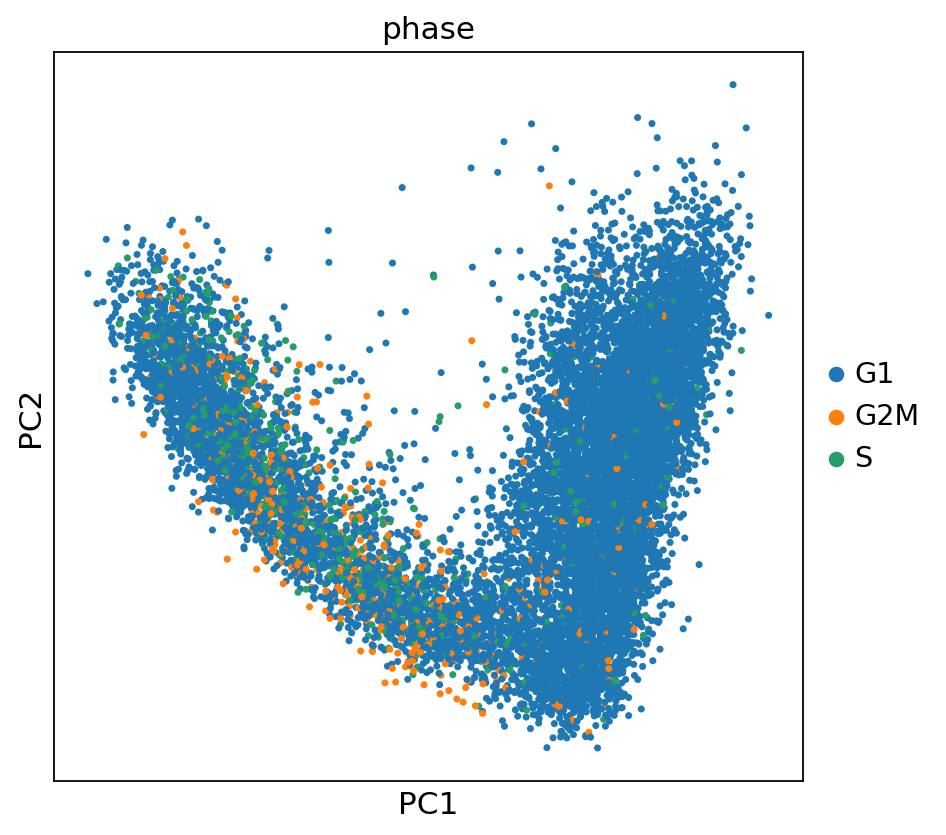

In [19]:
sc.pl.pca(adata, color="phase", size=40)

Strange no grouping of activemcycling cells

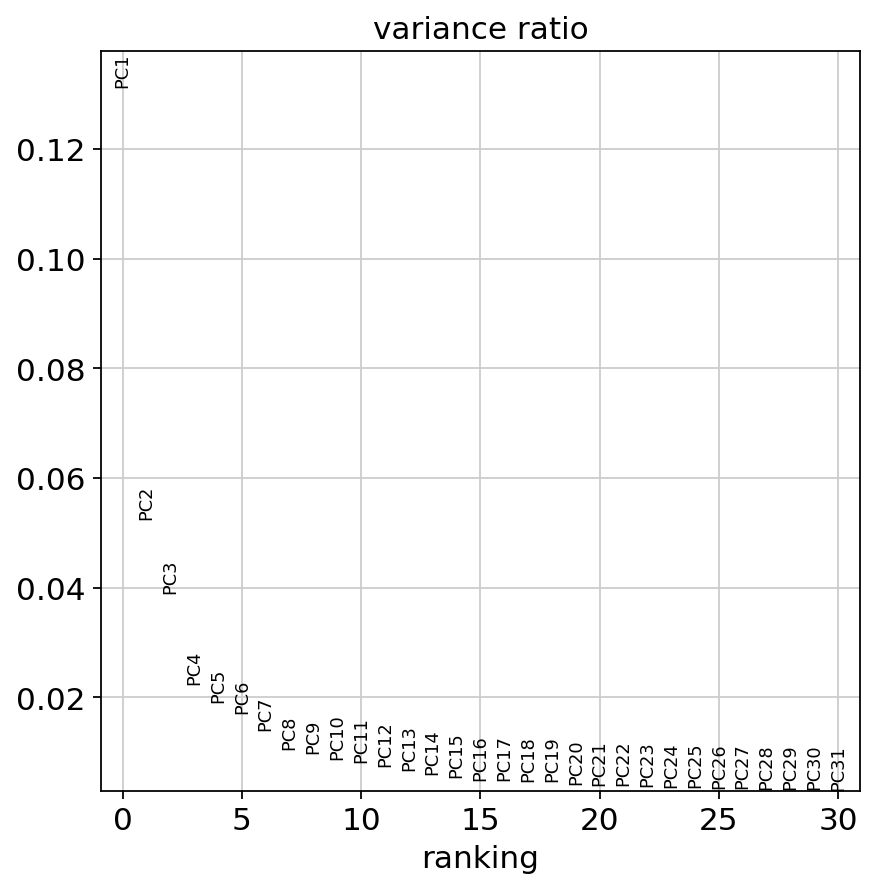

In [20]:
sc.pl.pca_variance_ratio(adata)

In [21]:
sc.pp.neighbors(adata, n_neighbors=30, n_pcs=10)

In [22]:
sc.tl.umap(adata)


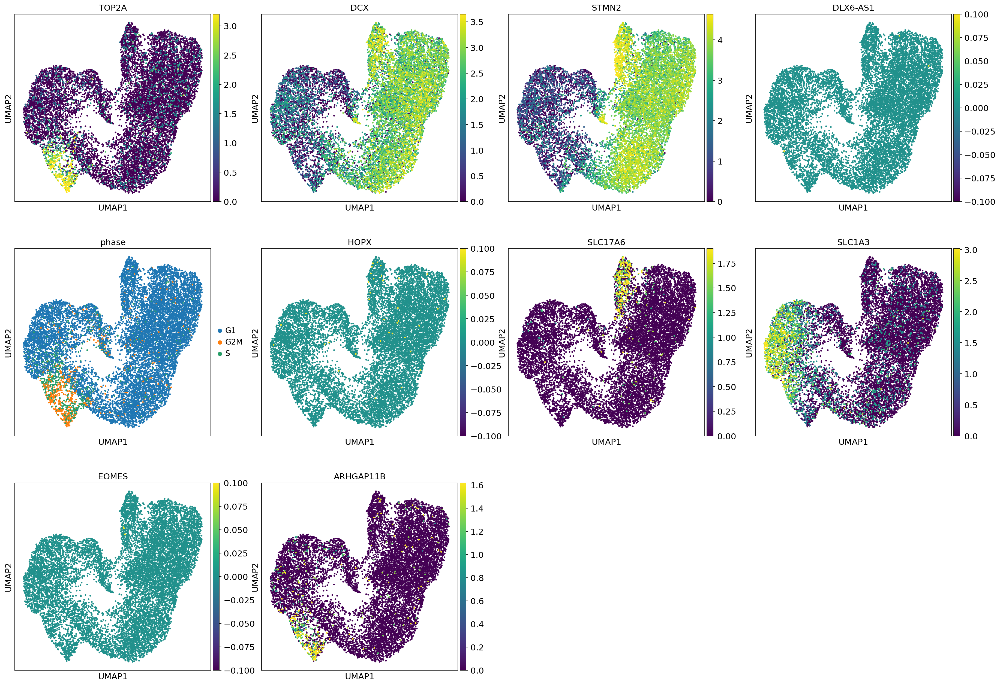

In [23]:
sc.pl.umap(adata, color=["TOP2A","DCX","STMN2", "DLX6-AS1","phase","HOPX","SLC17A6","SLC1A3","EOMES","ARHGAP11B"], ncols=4, size=30, vmin="p1", vmax="p99")

# Replicates check

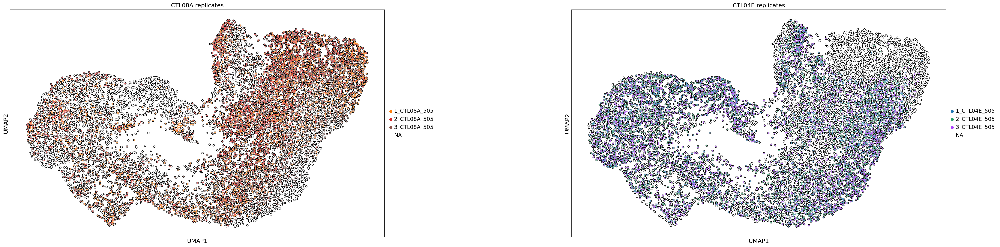

In [24]:
fig, axes = plt.subplots(1,len(adata.obs.line.unique()), figsize=(40, 10))

for line in enumerate(adata.obs.line.unique()):
    SampleIDs = adata.obs.loc[adata.obs.line == line[1],"sample_id"].unique().tolist()
    axes[line[0]] = sc.pl.umap(adata, size = 40, add_outline=True,ncols=2, color=["sample_id"],title="{} replicates".format(line[1]),na_color="white",
                     groups=SampleIDs, vmin='p1', vmax='p99', show=False, ax=axes[line[0]])
plt.subplots_adjust(wspace=.5)
fig.show()

# Leiden stability check

In [25]:
LeidenDF = pd.DataFrame()
for i in  np.linspace(.5,1, 6):
    t = sc.tl.leiden(adata, resolution=i, copy =True, random_state=1)
    LeidenDF = pd.concat([LeidenDF,t.obs["leiden"].to_frame(name=round(i,2))], axis = 1)

In [26]:
sc.tl.leiden(adata, resolution=.6,  random_state=1)


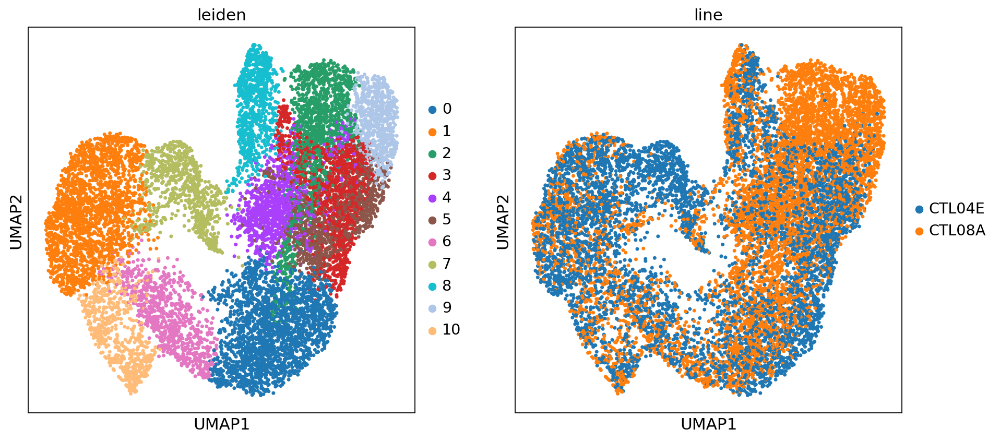

In [27]:

sc.pl.umap(adata, color=["leiden","line"], size=40)

In [28]:
colorby = 0.6
LeidenDF["color"] = LeidenDF[colorby].astype(int)


fig = px.parallel_categories(LeidenDF,

                             dimensions=[i for i in LeidenDF.columns if  "color" not in str(i)],

                             color_continuous_scale=px.colors.sequential.Jet,color="color",


                             width=1000,height=700)

fig.show()

In [29]:
sc.tl.rank_genes_groups(adata, method="wilcoxon", groupby="leiden")

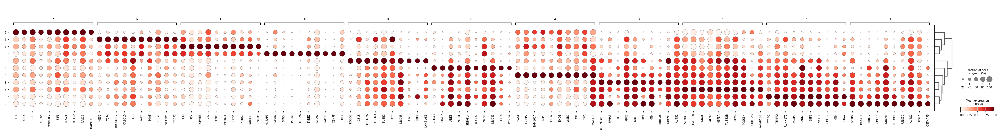

In [30]:
sc.pl.rank_genes_groups_dotplot(adata, standard_scale="var", n_genes=10)

# GO

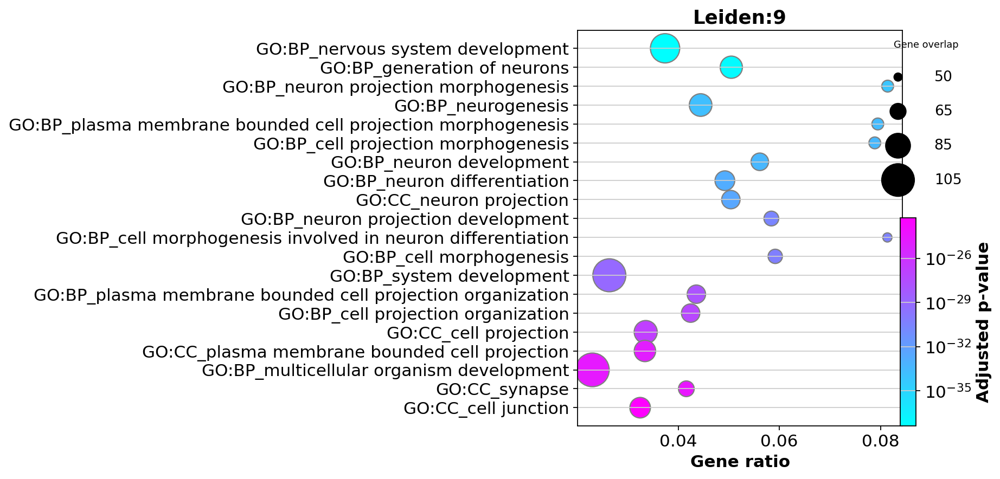

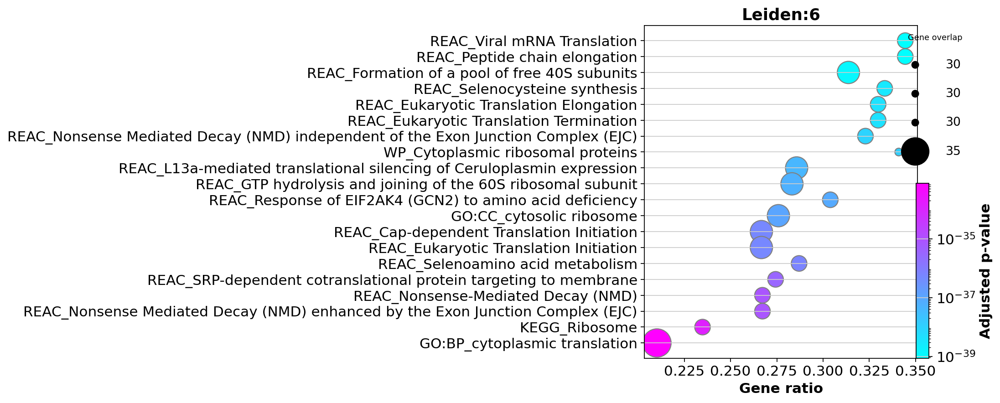

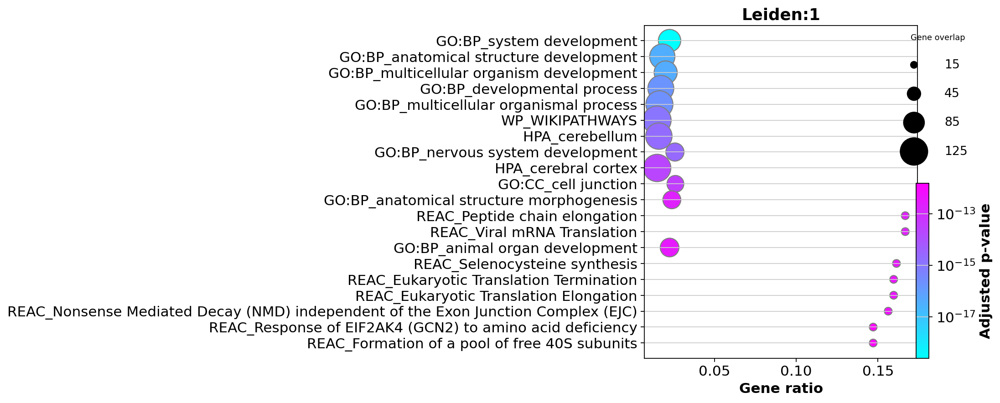

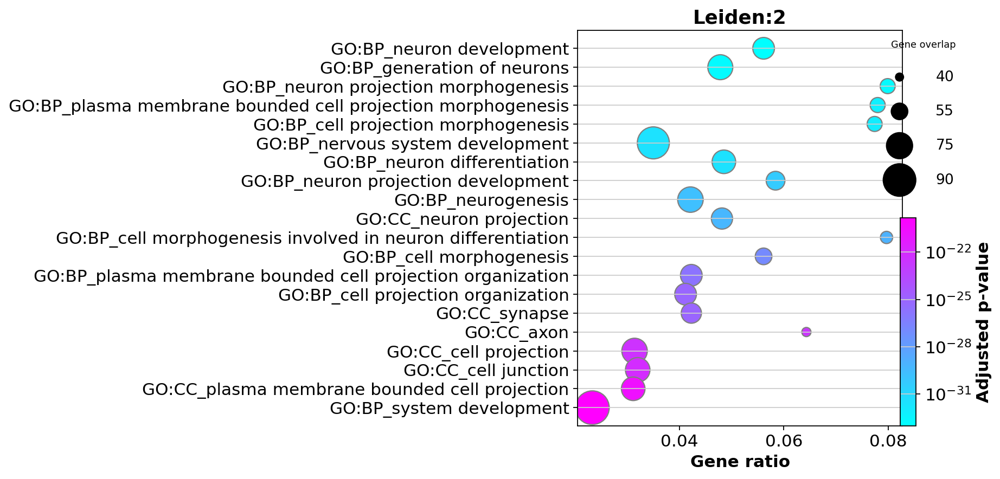

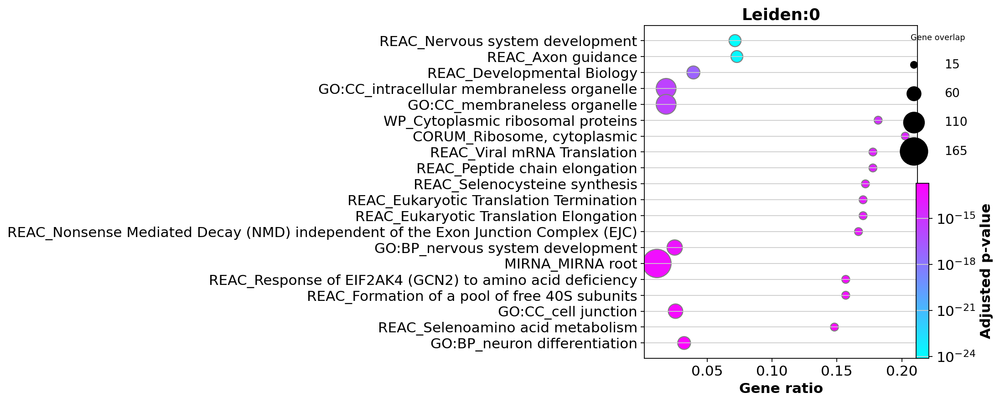

...

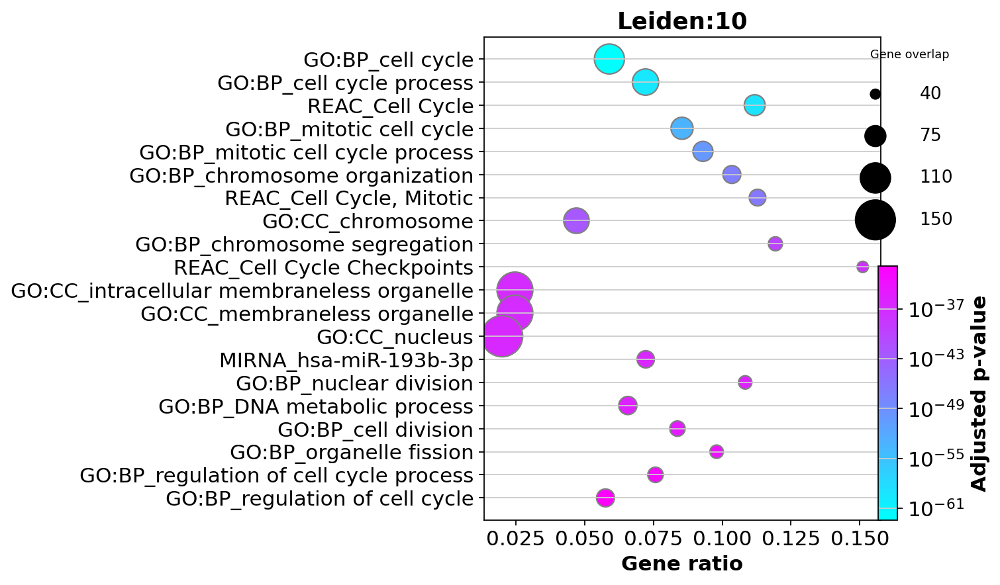

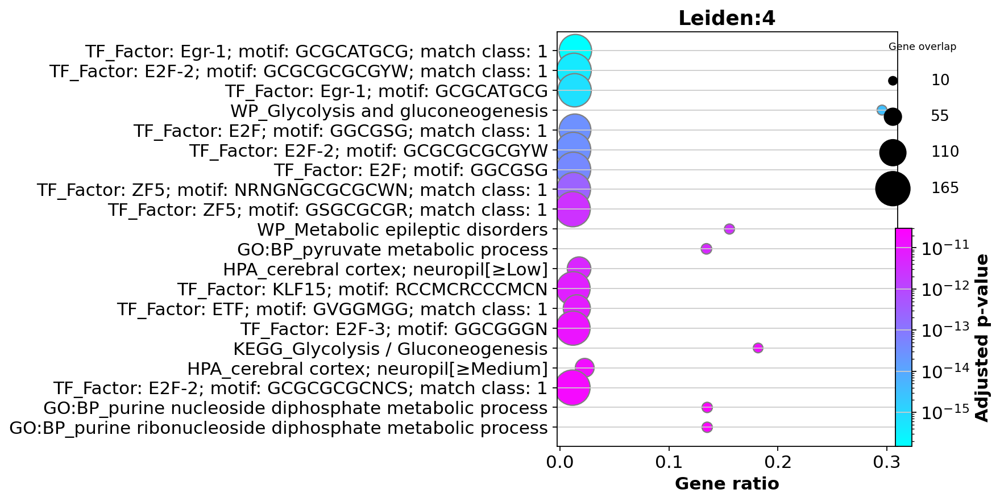

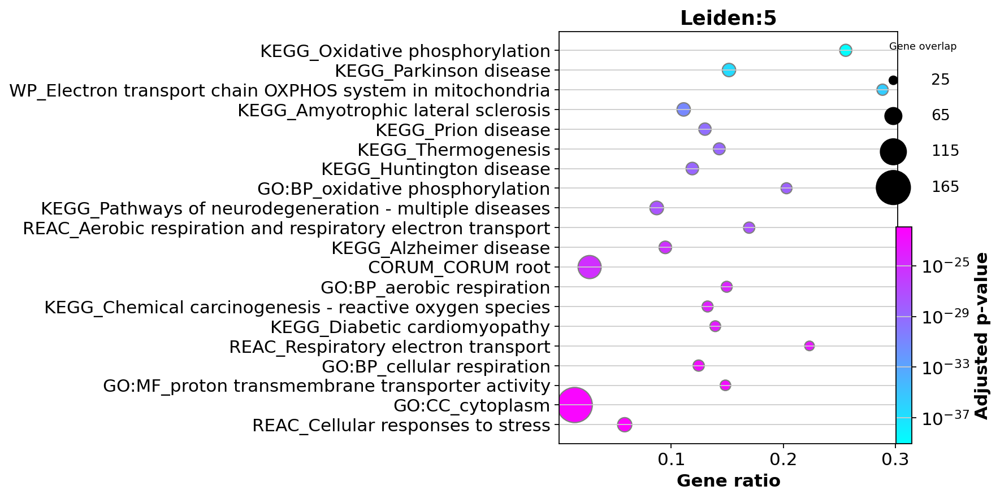

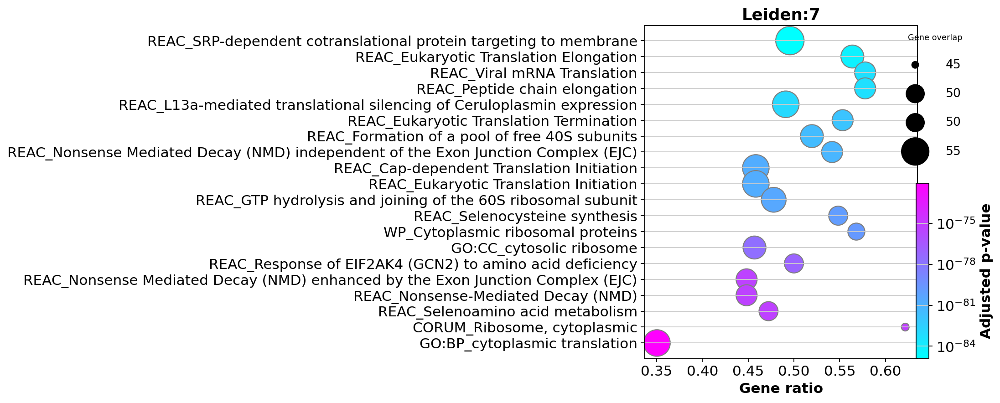

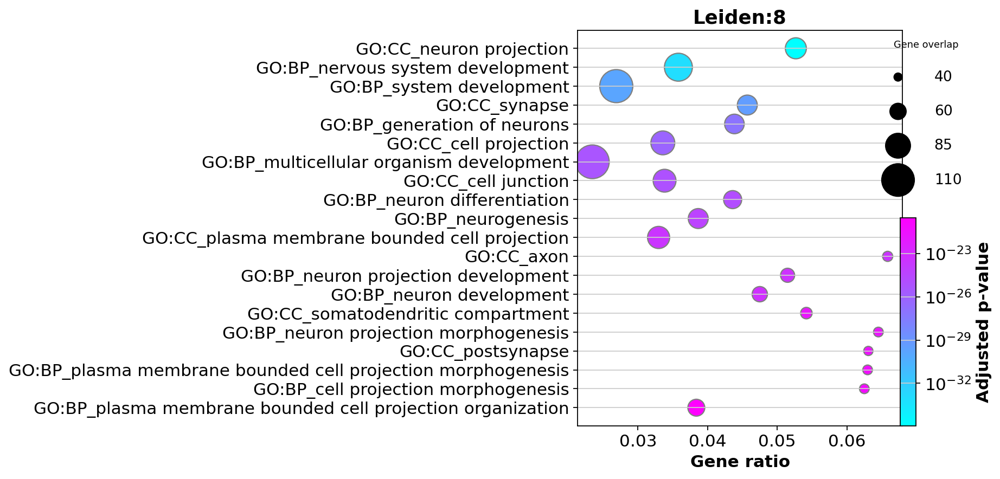

In [31]:
sys.path.insert(1, homeDir+"/utils")
from plotenrich import *

from gprofiler import GProfiler


gp = GProfiler(return_dataframe=True)

for leiden in adata.obs["leiden"].unique().tolist():
	DEGsLeiden = sc.get.rank_genes_groups_df(adata, group=leiden).set_index("names").head(200).index.tolist()
	ontology = gp.profile(organism='hsapiens',
							query=DEGsLeiden,
							no_evidences=False,
							background=adata.var_names.tolist())
	ontology = ontology[(ontology.intersection_size > 10)]
	if ontology.shape[0] > 0:
		plot_enrich(ontology,save=False, title=f"Leiden:{leiden}")
	plt.show()

# Ingestion

In [32]:
PoliudakisRef = sc.read_h5ad("/group/testa/Users/davide.castaldi/Polaroids_spinoff/2_GenerateReferences/cortex.Reference.h5ad")

In [33]:
RefVars = set(PoliudakisRef.var_names.tolist())
QueryVars = set(adata.var_names.tolist())
if RefVars != QueryVars:
    print("Found mismatch between Ref and Query vars: will unify")
    CommonGenes = list(RefVars.intersection(QueryVars))
    ref_adata = PoliudakisRef[:,CommonGenes].copy()
    query_adata = adata[:,CommonGenes].copy()

Found mismatch between Ref and Query vars: will unify


In [34]:
sc.tl.ingest(query_adata, ref_adata, obs="LabelTransfer")

# Add to mapped obs list


In [35]:
adata.obs["LabelTransfer"] = query_adata.obs["LabelTransfer"]

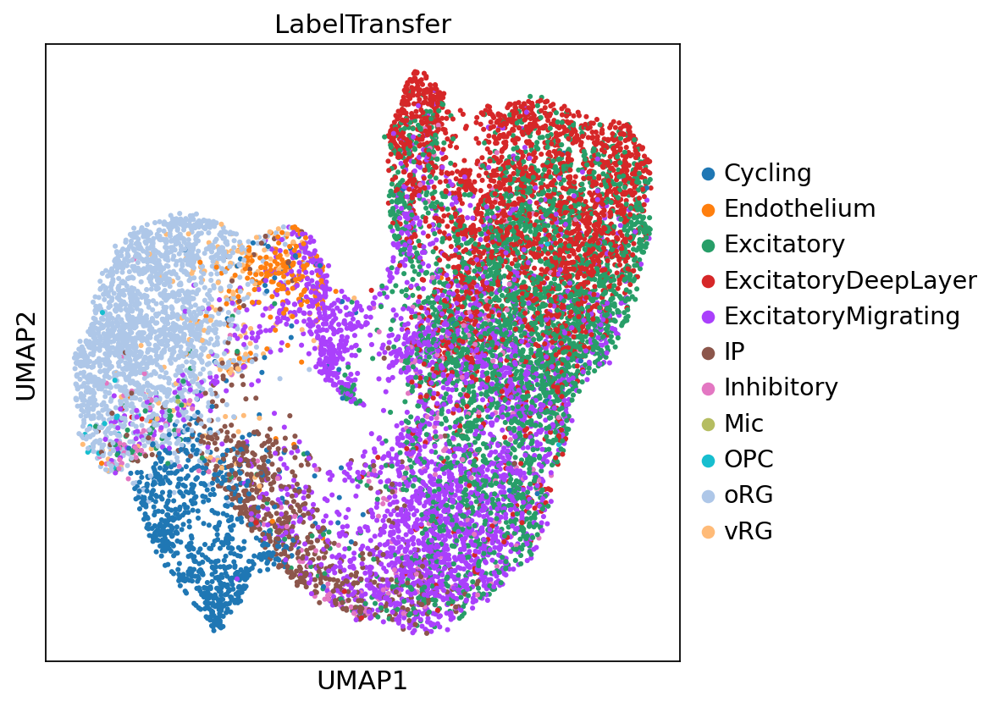

In [36]:
sc.pl.umap(adata, color=["LabelTransfer"], ncols=4, size=30, vmin="p1", vmax="p99")